In [192]:
import os
import sys
sys.path.append(os.path.join(os.getcwd(),'..','..','..'))
from ursse.hydra_harp_file_reader import HydraHarpFile
from ursse.LED_tests.data_analyzis import calc_Fano, get_time_window_hist, calc_Fano_from_counts_per_time_window
import numpy as np
import pandas as pd
import seaborn as sns
from ursse.data_processing import \
    get_event_delays, plot_arrival_time_hist, get_events_array, get_fanos, \
    plot_fanos_hist, process_file, read_event_delays, save_event_delays
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams['figure.figsize'] = [15, 7.5]
plt.rcParams.update({'font.size': 16,'legend.fontsize':16})
import ursse.path_assistant as pa
shift = pa.PathAssistant('shift_02_28_2020')

In [193]:
df, n_revolutions = read_event_delays(shift.get_time_stamp_file_path('1el_002.ptu'))
t_delays = df.delay

In [194]:
gate = (61000, 66000)
dt=0.1  # sec

In [195]:
n = 500
i = 200

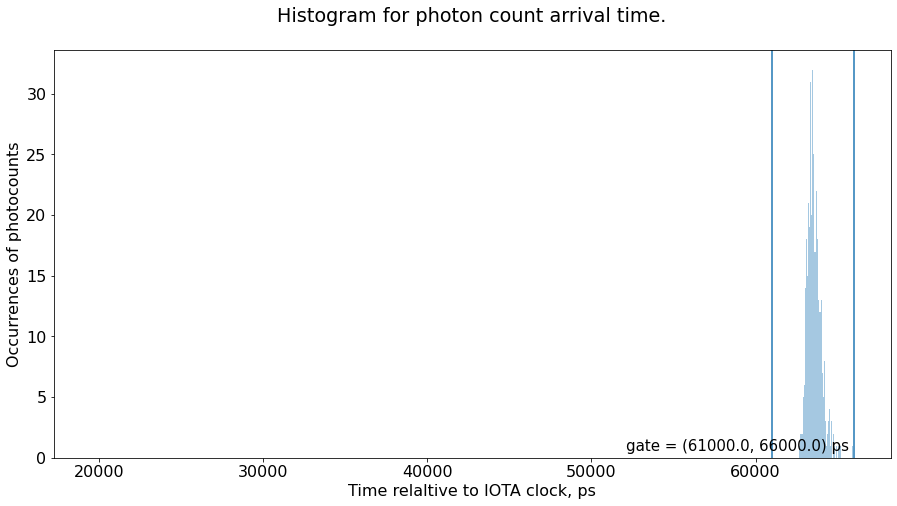

In [196]:
plot_arrival_time_hist(t_delays[i*n:(i+1)*n], gate=gate, bins=1000, yscale='linear')

In [197]:
n_revolutions*133e-9

59.866547461

In [198]:
t_delays_in_gate = t_delays[t_delays.between(gate[0],gate[1])]

In [199]:
len(t_delays_in_gate)/n_revolutions/133e-9

24722.22071874391

In [200]:
from config_ursse import get_from_config
iota_period_sec = get_from_config("IOTA_revolution_period")
dt_sec = get_from_config("dt")
iota_period_au = iota_period_sec/dt_sec

In [201]:
from ursse.time_structure import get_bucket_gates, get_rate_in_gate_Hz

In [202]:
four_gates = get_bucket_gates(gate)
four_gates

[(61000.0, 66000.0),
 (94250.0, 99250.0),
 (127500.00000000001, 132500.0),
 (27750.0, 32750.0)]

In [203]:
get_rate_in_gate_Hz(df, n_revolutions, gate)

24722.22071874391

In [204]:
bucket_dfs = [df[(df.delay > gate[0]) & (df.delay < gate[1])] for gate in four_gates]

In [394]:
dt=0.005

In [395]:
df0 = bucket_dfs[0]

In [396]:
revolutions_per_dt = dt/iota_period_sec
revolutions_per_dt

37593.984962406015

In [397]:
df0['index_of_dt_bin'] = (df0.revolution/revolutions_per_dt).astype(int)
df0['time_sec'] = df0['index_of_dt_bin']*dt

<ipython-input-397-27c4b84eb6f7>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-397-27c4b84eb6f7>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



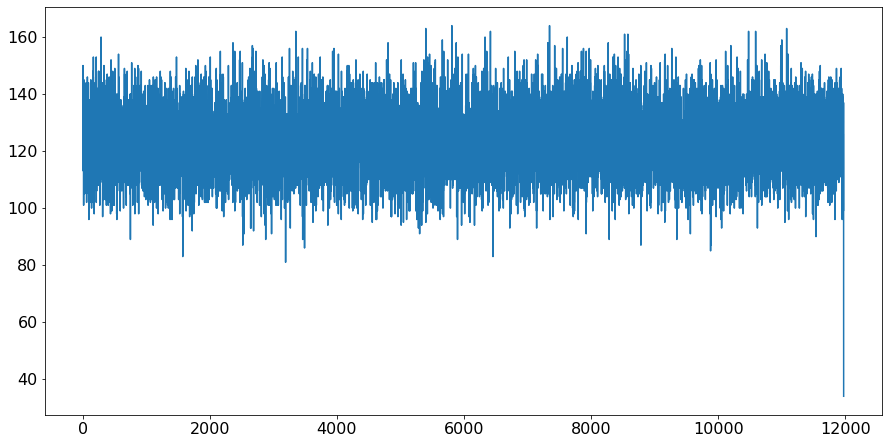

In [398]:
plt.plot(df0.groupby('index_of_dt_bin').delay.count())

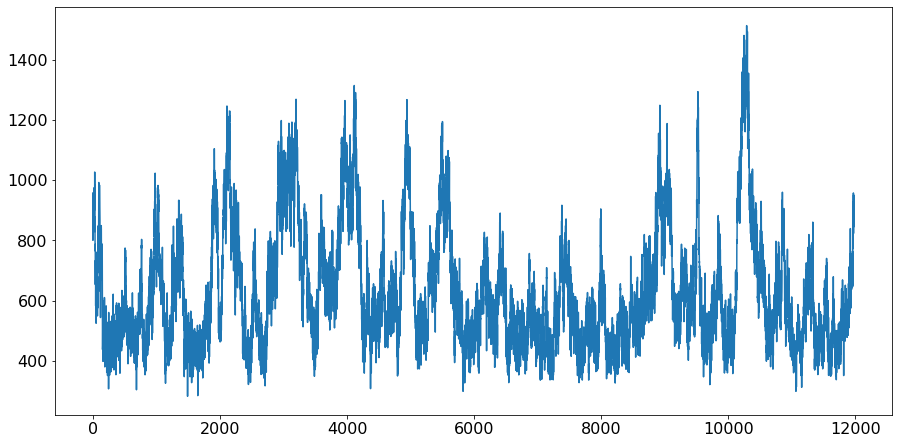

In [399]:
plt.plot(df0.groupby('index_of_dt_bin').delay.std())

In [400]:
xs = df0.groupby('index_of_dt_bin').revolution.apply(np.asarray)
ys = df0.groupby('index_of_dt_bin').delay.apply(np.asarray)

In [401]:
t0=2372

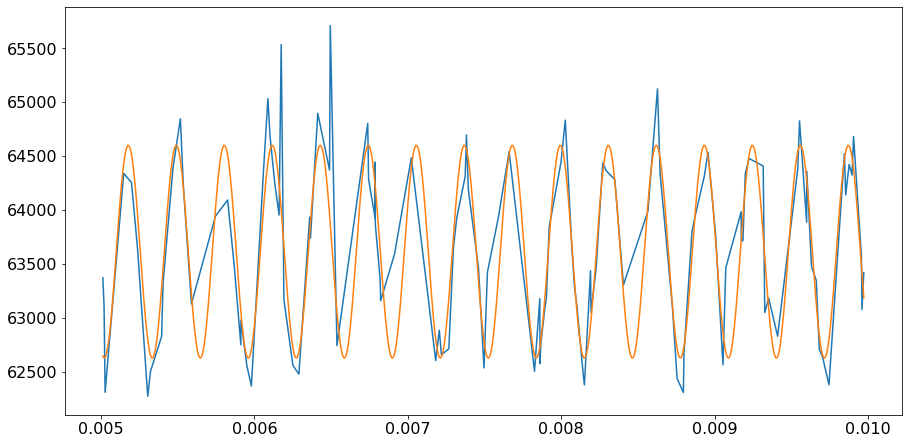

(985.823480014053, 2372, 4.012067972263142)

In [402]:
i = 1
x = xs[i]
x_sec = x*iota_period_sec
y = ys[i]
sns.lineplot(x=x_sec, y=y)
from scipy.optimize import curve_fit
def f(t, a0, A, B, T):
    return a0+A*np.cos(2*np.pi/T*t)+B*np.sin(2*np.pi/T*t)
p0 = (np.mean(y), np.std(y), np.std(y), t0)
popt, pcov = curve_fit(f, x, y, p0=p0)
a0, a, b, t = popt
perr = np.sqrt(np.diag(pcov))
x_fit = np.linspace(x[0],x[-1],10000)
x_fit_sec = x_fit*iota_period_sec
y_fit = f(x_fit, a0, a, b, t)
sns.lineplot(x_fit_sec, y_fit)
plt.show()
np.sqrt(a**2+b**2), t0, perr[3]

In [403]:
A = np.column_stack((np.ones(x.shape), np.cos(2*np.pi/t0*x), np.sin(2*np.pi/t0*x)))
a0, a, b = np.linalg.lstsq(A, y, rcond=None)[0]
amp = np.sqrt(a**2+b**2)
amp

971.128942873979

In [413]:
amps = []
for x, y in zip(xs, ys):
#     A = np.column_stack((np.ones(x.shape), np.cos(2*np.pi/t0*x), np.sin(2*np.pi/t0*x)))
#     a0, a, b = np.linalg.lstsq(A, y, rcond=None)[0]
    try:
        popt, pcov = curve_fit(f, x, y, p0=p0)
        a0, a, b, t = popt
        amp = np.sqrt(a**2+b**2)
        amps.append(amp)
    except:
        amps.append(np.nan)

In [414]:
plot_df = pd.DataFrame({'time': np.arange(len(amps))*dt, 'amp': amps})

Text(0.5, 0, 'sec')

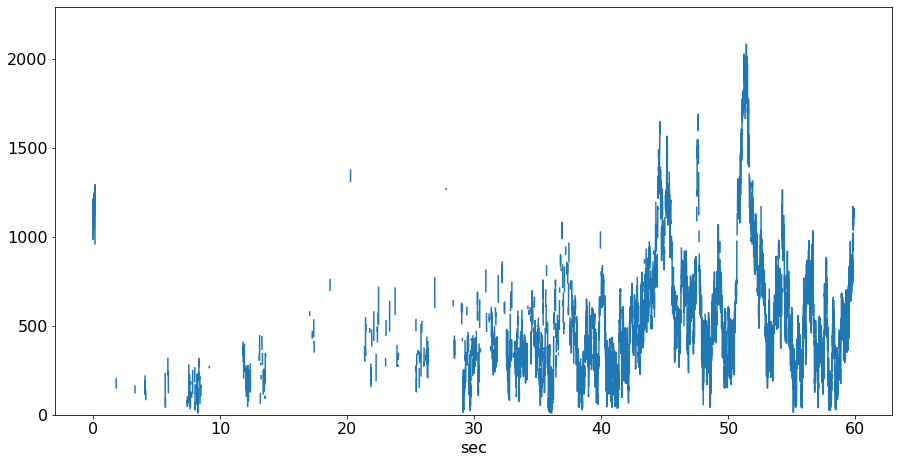

In [415]:
plt.plot(np.arange(len(amps))*dt, amps)
plt.ylim(0, 1.1*max(amps))
plt.xlabel('sec')

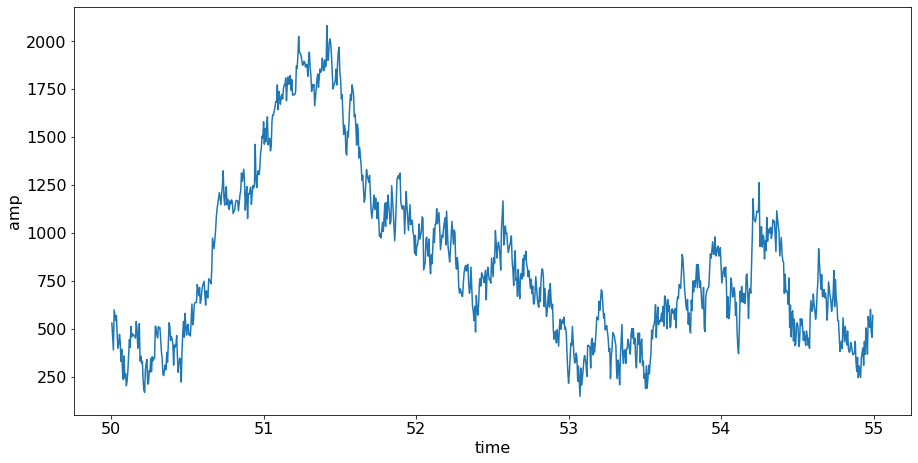

In [417]:
sns.lineplot(data=plot_df[(plot_df['time']>50) & ((plot_df['time']<55))], x="time", y='amp')

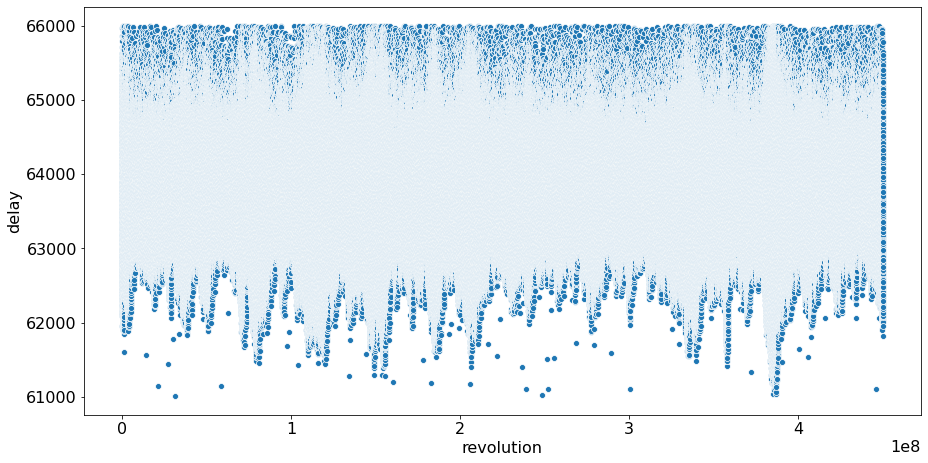

In [434]:
sns.scatterplot(data=df0[(df0['time_sec']>0) & ((df0['time_sec']<60))], x="revolution", y='delay')

In [455]:
candidate_df = df0[(df0['time_sec']>51.5) & ((df0['time_sec']<53))]
candidate_df = candidate_df.reset_index(drop=True)

In [463]:
candidate_df['revolution'] = candidate_df['revolution']-candidate_df['revolution'][0]
candidate_df['time_sec'] = candidate_df['time_sec']-candidate_df['time_sec'][0]
candidate_df['index_of_dt_bin'] = candidate_df['index_of_dt_bin']-candidate_df['index_of_dt_bin'][0]
candidate_df['delay'] = candidate_df['delay']-candidate_df['delay'].mean()

In [464]:
candidate_df

,revolution,delay,index_of_dt_bin,time_sec
0,0,411.071467,0,0.00
1,53,-859.928533,0,0.00
2,243,-1120.928533,0,0.00
3,302,-1887.928533,0,0.00
4,508,-1916.928533,0,0.00
...,...,...,...,...
36753,11238801,-134.928533,298,1.49
36754,11239075,-98.928533,298,1.49
36755,11239240,519.071467,298,1.49
36756,11239316,-122.928533,298,1.49


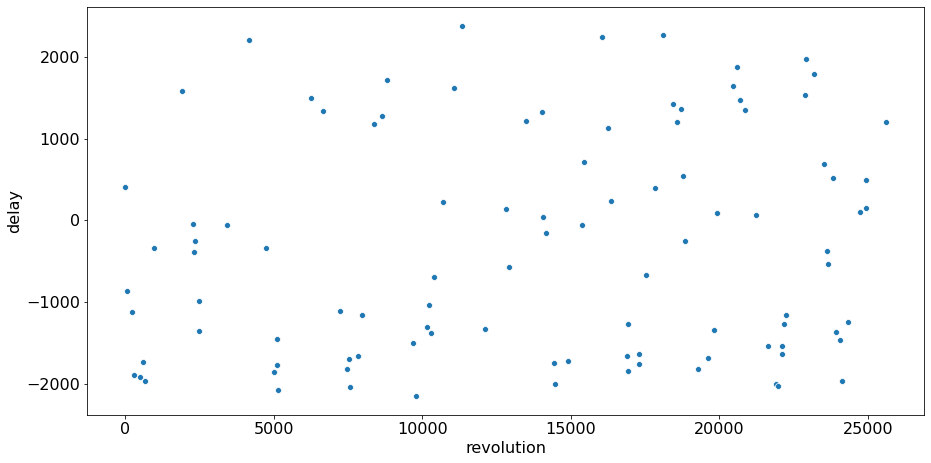

In [465]:
sns.scatterplot(data=candidate_df.iloc[:100,:], x="revolution", y='delay')

In [475]:
import plotly.express as px

In [498]:
len(candidate_df.index)

36758

In [541]:
a0 = 0

In [548]:
t0=2372
cand_df_slice = candidate_df[(candidate_df['revolution']<1.2e6)]
x = cand_df_slice["revolution"].values
y = cand_df_slice['delay'].values
def f(t, A, B, T):
    return np.exp(-a0*t)*(A*np.cos(2*np.pi/T*t)+B*np.sin(2*np.pi/T*t))
def f_damp(t, a0, A, B, T):
    return np.exp(-a0*t)*(A*np.cos(2*np.pi/T*t)+B*np.sin(2*np.pi/T*t))
p0 = (np.std(y), np.std(y), t0)
popt, pcov = curve_fit(f, x, y, p0=p0)
a, b, t = popt
x_fit = np.linspace(x[0],x[-1],10000)
y_fit = f_damp(x_fit, a0, a, b, t)
amp = np.sqrt(a**2+b**2)
amp, t, a0

(1431.0266849188042, 2364.8799372423246, 0)

In [551]:
b

-1339.3097988073073

In [596]:
a0 = 0.25e-6
a = 504.0700702962164
b = -1339.3097988073073
aux = 1.5
a = aux*a
b = aux*b
t = 2364.8799372423246
cand_df_slice = candidate_df[(candidate_df['revolution']<2e6)]

x = cand_df_slice["revolution"].values
y = cand_df_slice['delay'].values
x_fit = np.linspace(x[0],x[-1],10000)
y_fit = f_damp(x_fit, a0, a, b, t)
fig = px.scatter(cand_df_slice, x="revolution", y="delay")
fig.add_scatter(x=x_fit, y=y_fit, mode='lines')
fig.show()

In [589]:
a0/iota_period_sec

1.8796992481203005

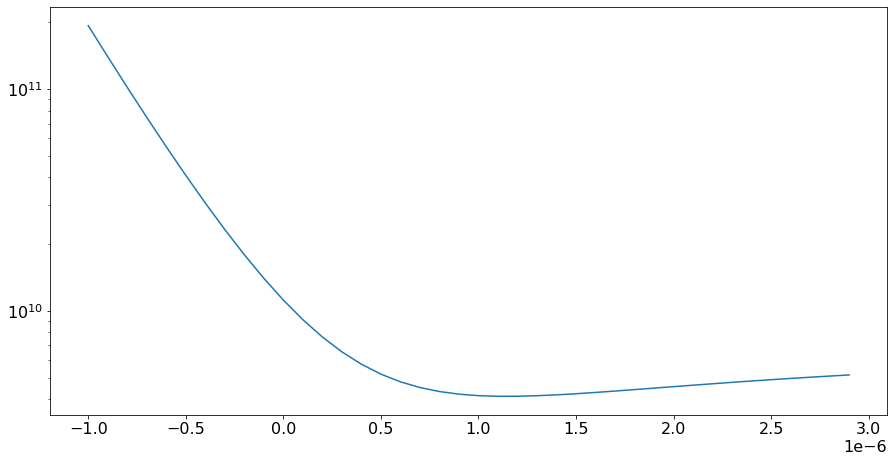

In [584]:
a0s = np.arange(-1e-6, 3e-6, 1e-7)
disc = [np.sum((y-f_damp(x, a0_, a, b, t))**2) for a0_ in a0s]
plt.plot(a0s, disc)
plt.yscale('log')

In [213]:
nbins=30
y_max = df0.groupby('index_of_dt_bin').delay.apply(lambda x: max(np.histogram(np.asarray(x), bins=nbins, range=gate)[0])).max()

In [214]:
bins = np.histogram([], bins=nbins, range=gate)[1]
bin_centers = (bins[1:]+bins[:-1])/2

In [215]:
hists = (df0.groupby('index_of_dt_bin').delay.apply(lambda x: np.histogram(np.asarray(x), bins=nbins, range=gate)[0])).to_list()

In [216]:
n_dt_bins = int(n_revolutions/revolutions_per_dt)

In [217]:
all_bin_centers = np.tile(bin_centers, n_dt_bins)
all_hists = np.concatenate(hists)[:nbins*n_dt_bins]
all_indexes = np.ravel(np.ones(bin_centers.shape)*(np.arange(n_dt_bins)[:, None])).astype(int)
hist_df = pd.DataFrame({'bin_center': all_bin_centers,
                        'counts': all_hists,
                        'time_index':all_indexes})
hist_df['time_sec'] = dt*hist_df['time_index']
y_max = hist_df['counts'].max()

In [218]:
hist_df

,bin_center,counts,time_index,time_sec
0,61083.333333,0,0,0.0
1,61250.000000,0,0,0.0
2,61416.666667,0,0,0.0
3,61583.333333,0,0,0.0
4,61750.000000,0,0,0.0
...,...,...,...,...
35905,65250.000000,18,1196,59.8
35906,65416.666667,5,1196,59.8
35907,65583.333333,6,1196,59.8
35908,65750.000000,5,1196,59.8


In [579]:
fig = px.bar(hist_df, x="bin_center", y="counts",
  animation_frame="time_index", range_x=gate, range_y=[0, 1.1*y_max], labels={'x':'time, ps', 'y':'count'})
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = int(dt*1000)
fig.layout.updatemenus[0].buttons[0].args[1]["transition"]["duration"] = 0
fig.show()

In [186]:
fig = px.histogram(df0, x="delay", nbins=nbins, animation_frame="index_of_dt_bin",
                   hover_data=df.columns, range_x=gate, range_y=[0,1.1*y_max])
fig.show()

In [74]:
np.histogram([1,2,3,4,5], bins=5, range=(-10,10))

(array([0, 0, 1, 4, 0]), array([-10.,  -6.,  -2.,   2.,   6.,  10.]))

In [ ]:
px.histogram()

In [3]:
import plotly.express as px

df = px.data.gapminder()

fig = px.bar(df, x="continent", y="pop", color="continent",
  animation_frame="year", animation_group="country", range_y=[0,4000000000])
fig.show()

In [ ]:
df

In [4]:
df

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
0,Afghanistan,Asia,1952,28.801,8425333,779.445314,AFG,4
1,Afghanistan,Asia,1957,30.332,9240934,820.853030,AFG,4
2,Afghanistan,Asia,1962,31.997,10267083,853.100710,AFG,4
3,Afghanistan,Asia,1967,34.020,11537966,836.197138,AFG,4
4,Afghanistan,Asia,1972,36.088,13079460,739.981106,AFG,4
...,...,...,...,...,...,...,...,...
1699,Zimbabwe,Africa,1987,62.351,9216418,706.157306,ZWE,716
1700,Zimbabwe,Africa,1992,60.377,10704340,693.420786,ZWE,716
1701,Zimbabwe,Africa,1997,46.809,11404948,792.449960,ZWE,716
1702,Zimbabwe,Africa,2002,39.989,11926563,672.038623,ZWE,716
